<a href="https://colab.research.google.com/github/abj-paul/Data-Science/blob/master/Image_Augmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install imgaug

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
!pip install ipyplot

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.6 MB 15.6 MB/s 


In [35]:
import imageio
import imgaug as ia
import imgaug.augmenters as iaa
import ipyplot


        WARNING! Google Colab Environment detected!
        You might encounter issues while running in Google Colab environment.
        If images are not displaying properly please try setting `force_b64` param to `True`.
        


In [12]:
# Mounting Dataset Drive
!pwd

/content


In [9]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [19]:
!ls drive/Shareddrives -alh

total 0


In [30]:
!ls drive/MyDrive/temp/Dataset/chest_xray/NORMAL -alh | wc -l

201


In [45]:
input_img = imageio.imread('../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/IM-0006-0001.jpeg')

In [33]:
#Horizontal Flip
hflip= iaa.Fliplr(p=1.0)
input_hf= hflip.augment_image(input_img)


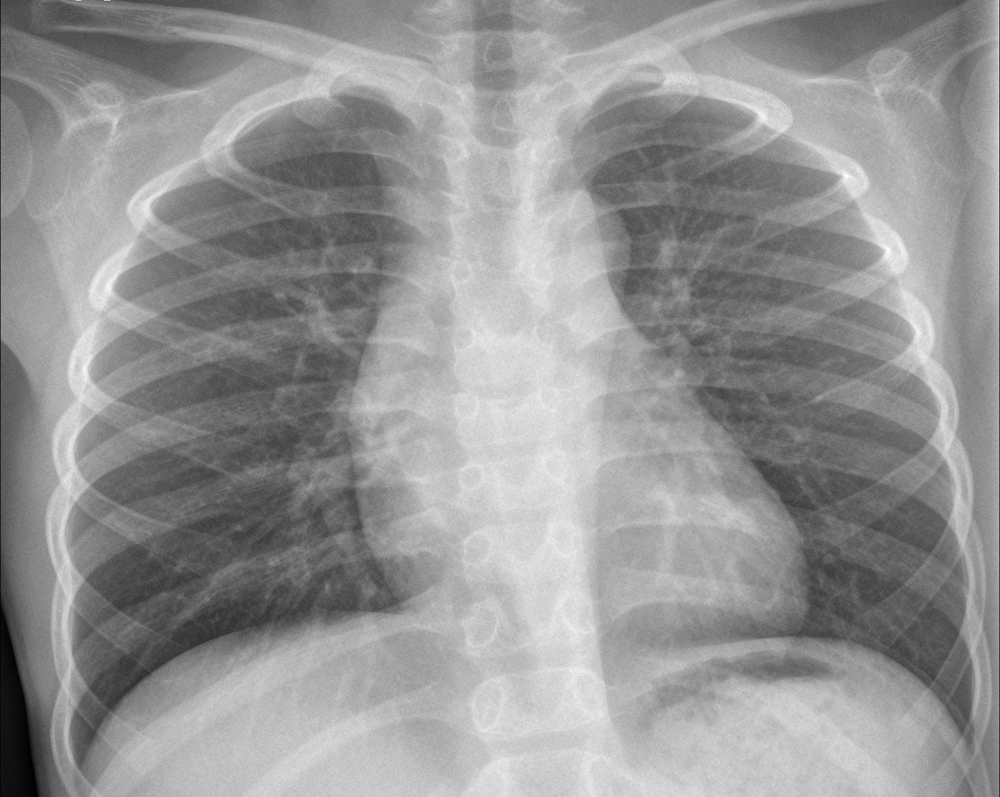
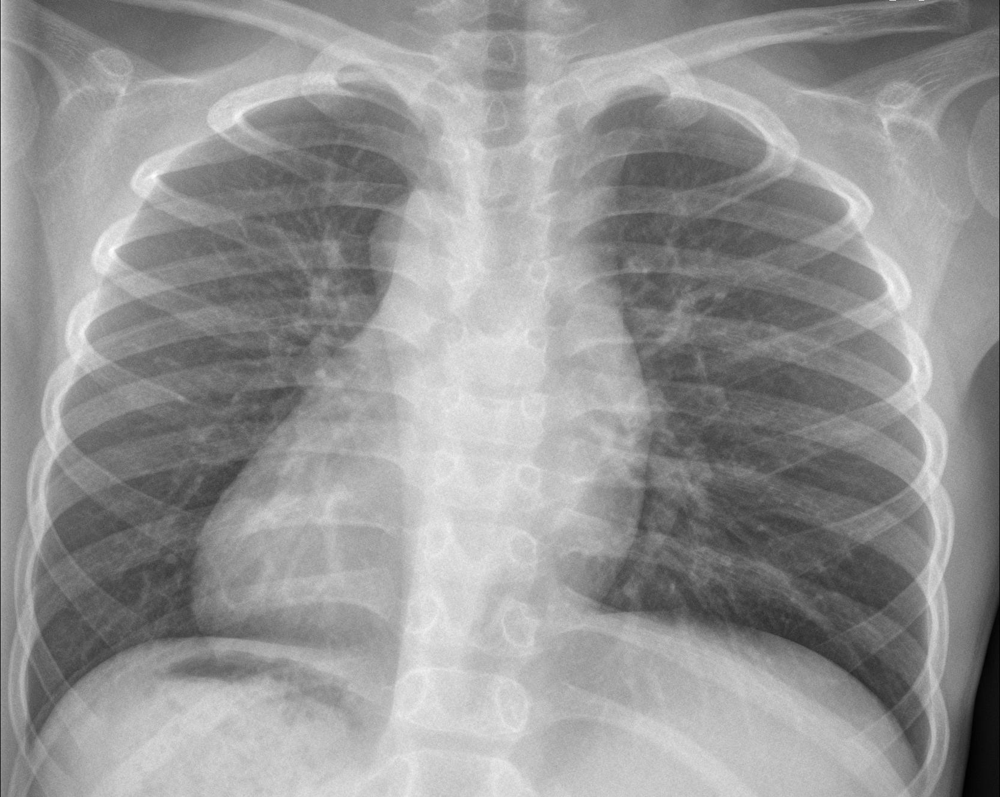
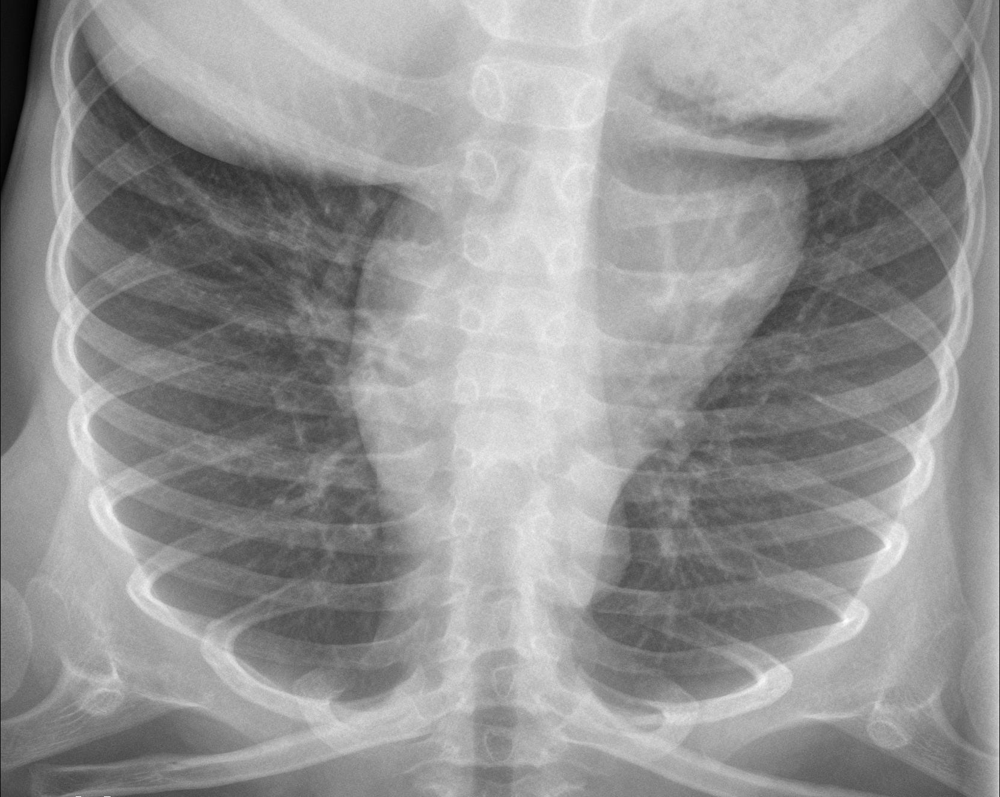


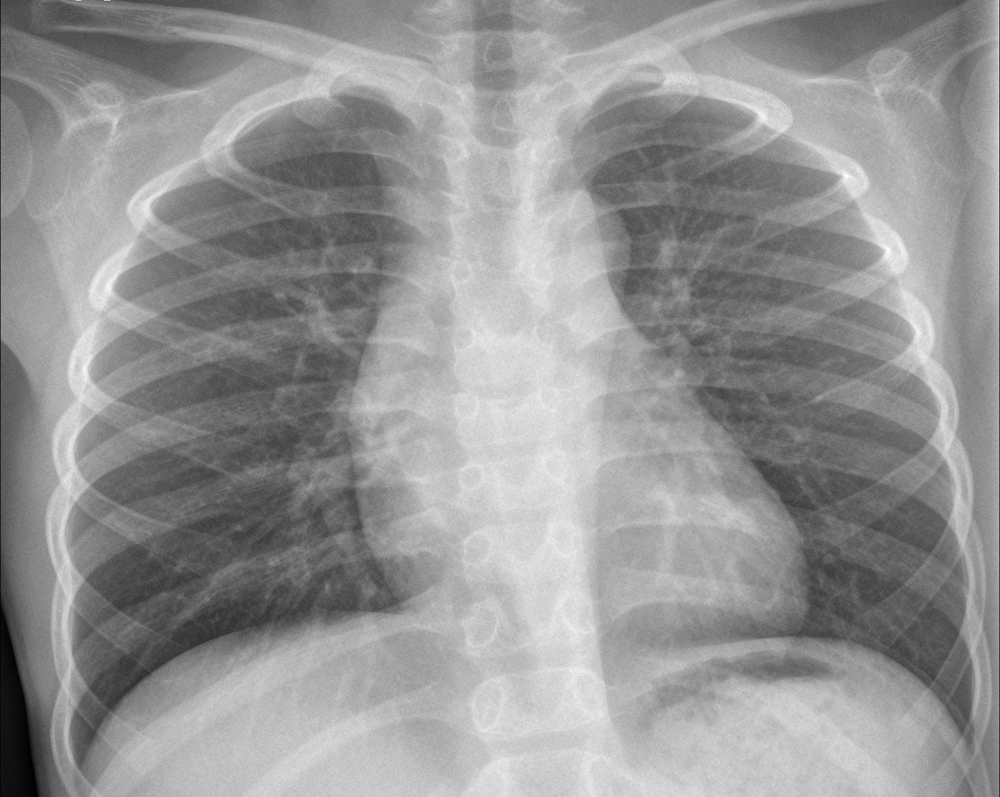
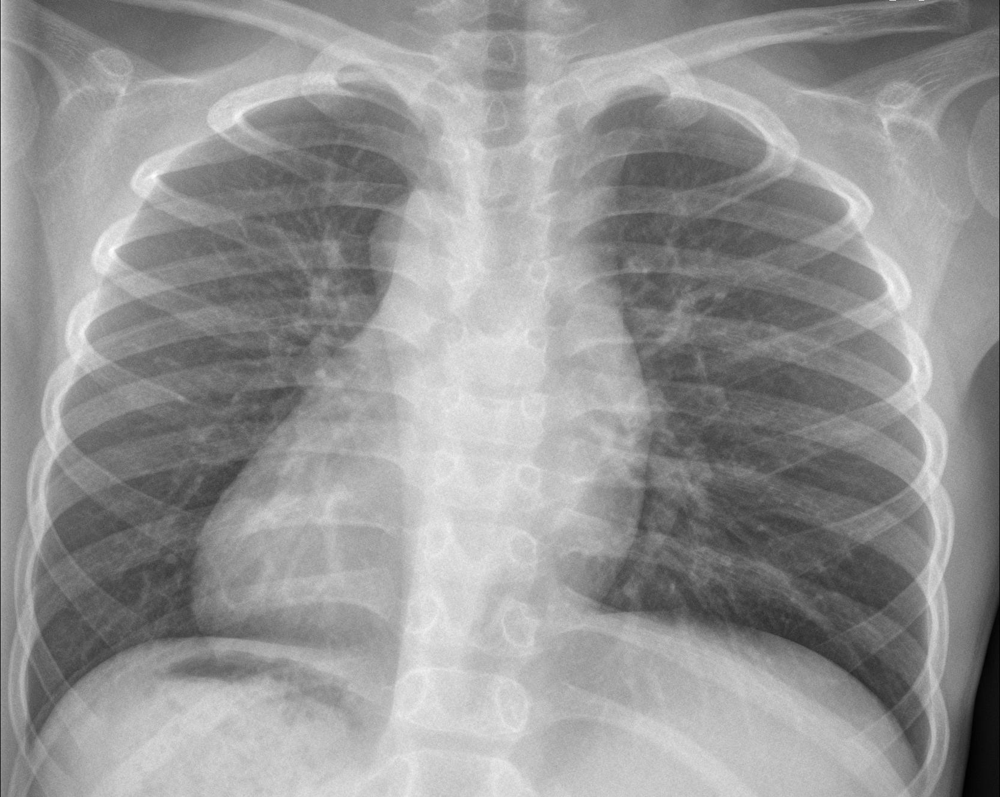
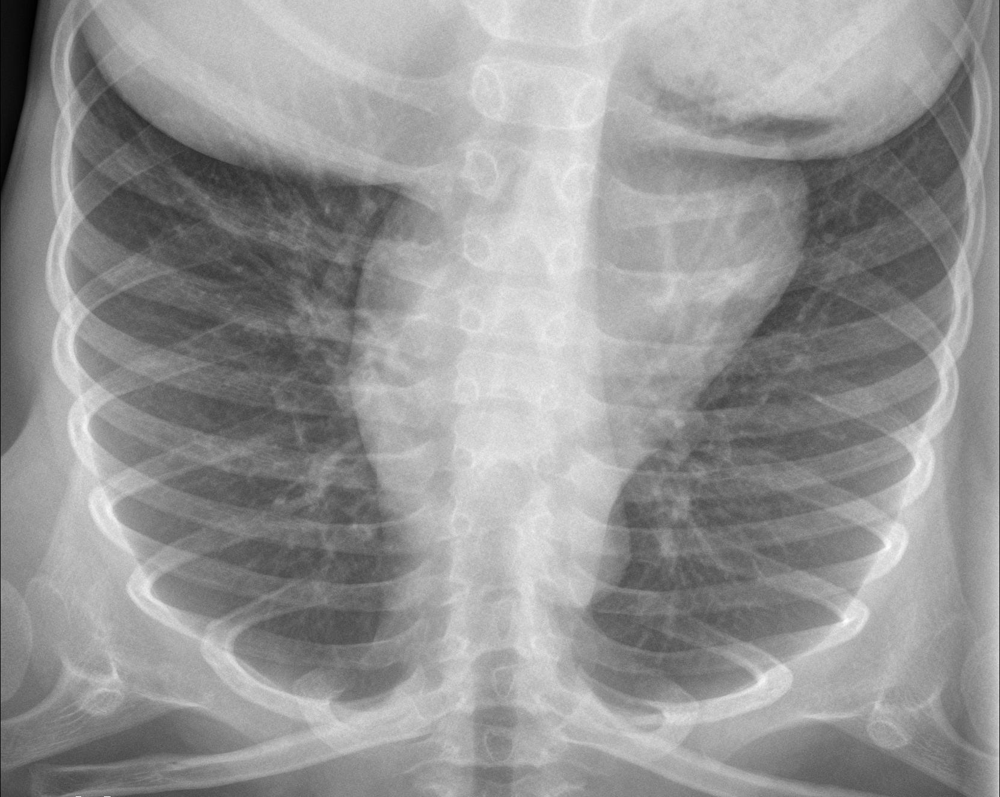

In [46]:
#Vertical Flip
vflip= iaa.Flipud(p=1.0) 
input_vf= vflip.augment_image(input_img)
images_list=[input_img, input_hf, input_vf]
labels = ['Original', 'Horizontally flipped', 'Vertically flipped']
ipyplot.plot_images(images_list,labels=labels,img_width=180)


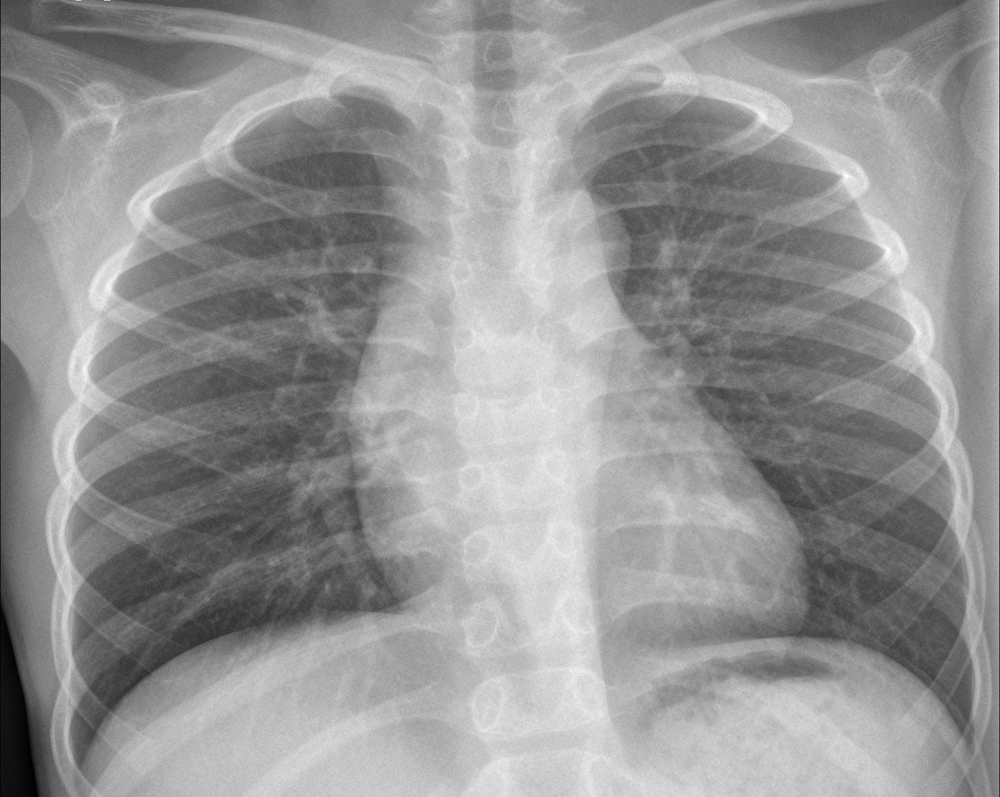
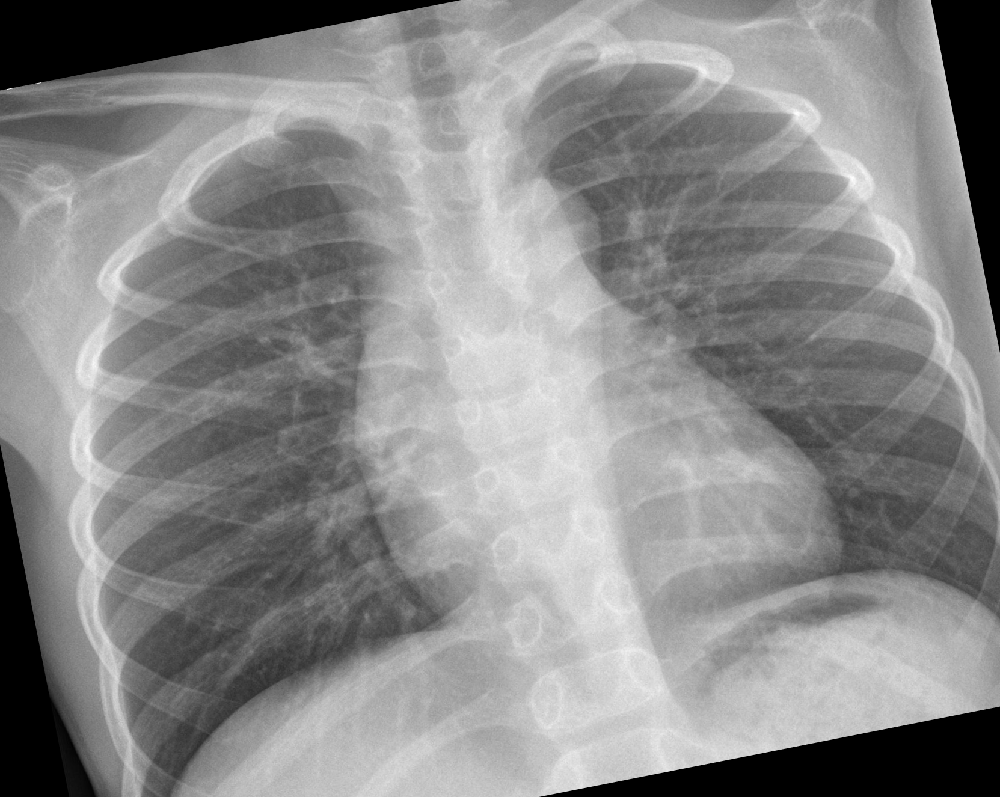


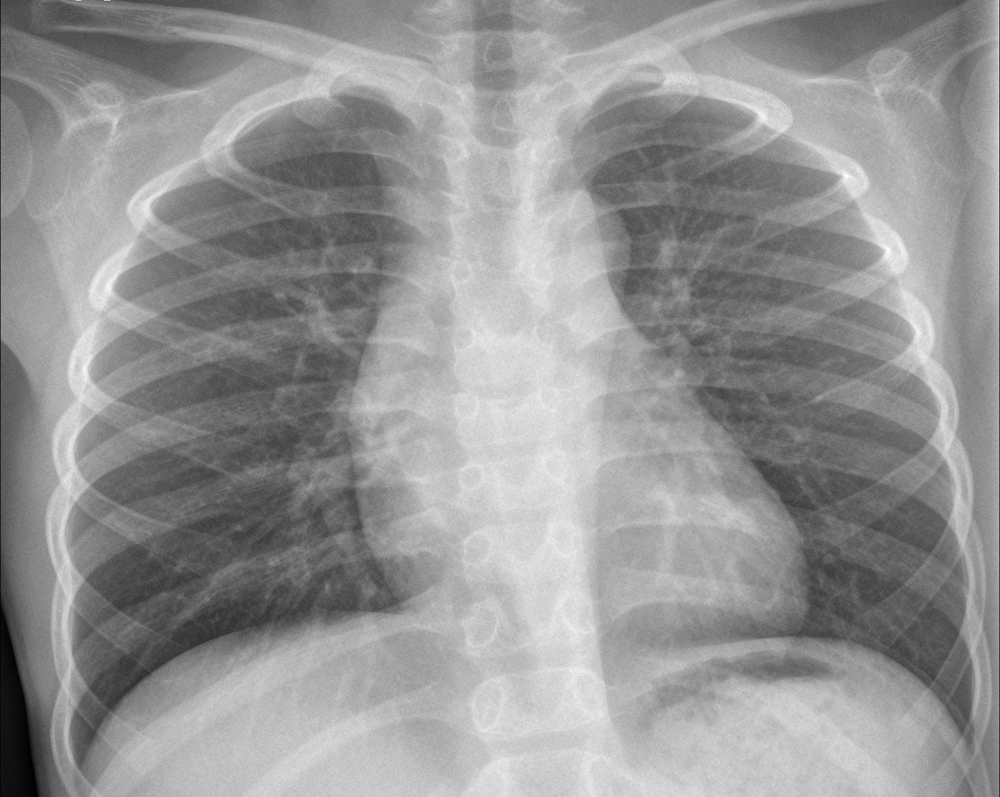
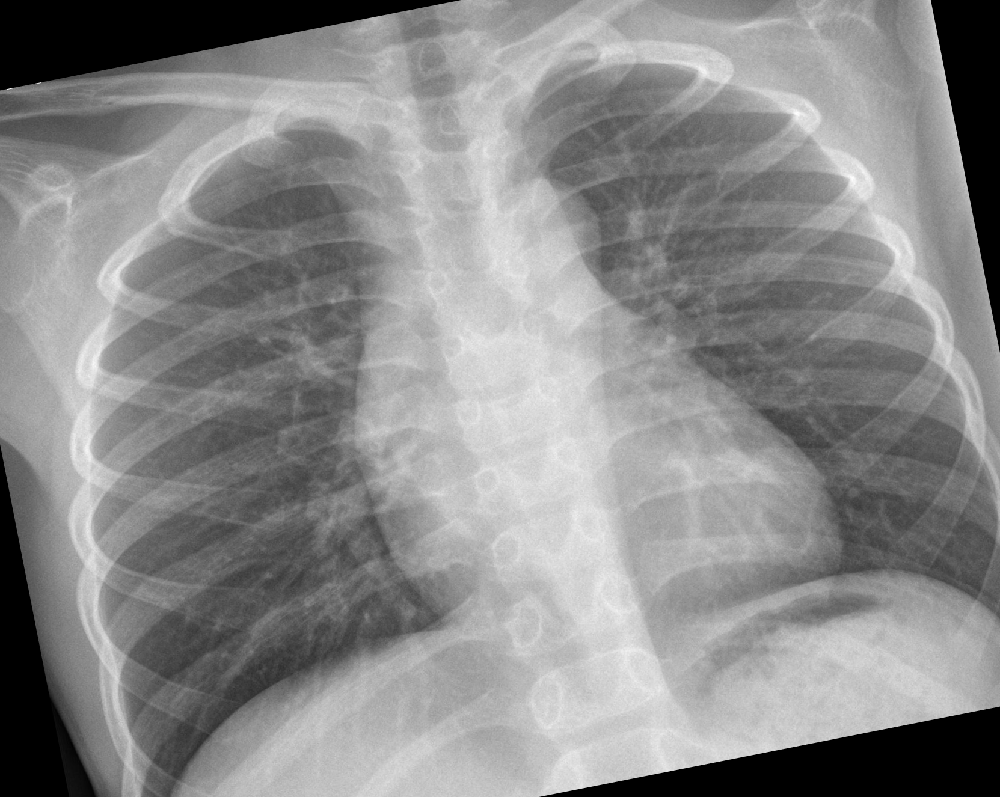

In [39]:
# Image Rotation
rot1 = iaa.Affine(rotate=(-50,20))
input_rot1 = rot1.augment_image(input_img)
images_list=[input_img, input_rot1]
labels = ['Original', 'Rotated Image']
ipyplot.plot_images(images_list,labels=labels,img_width=180)


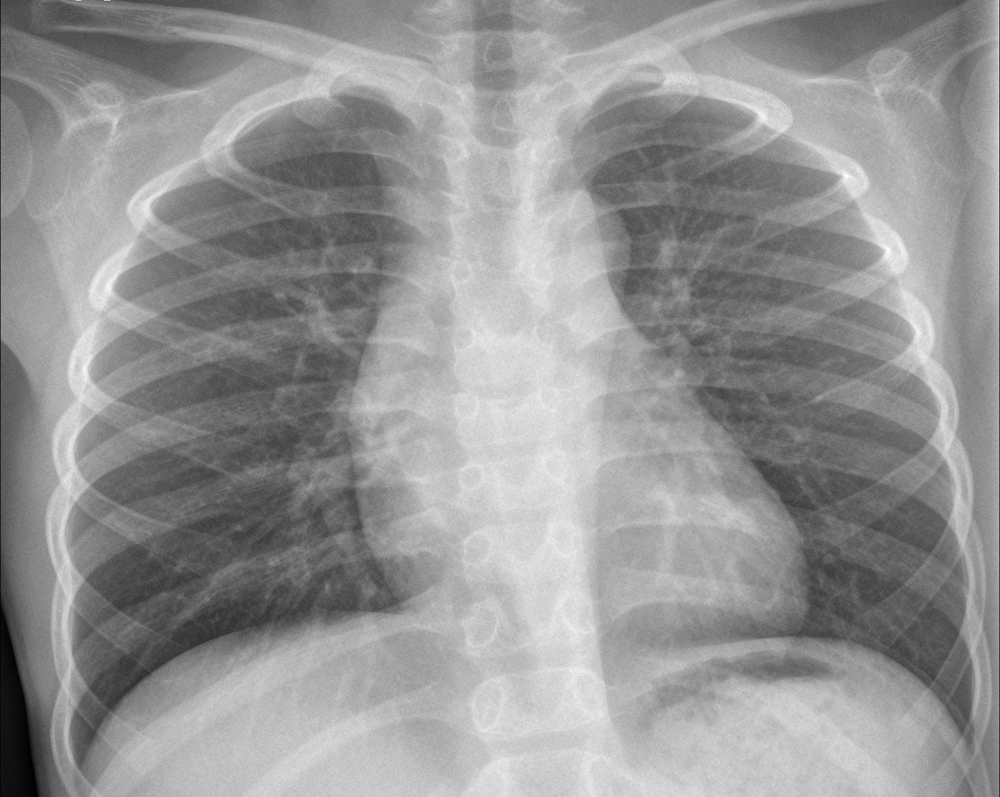
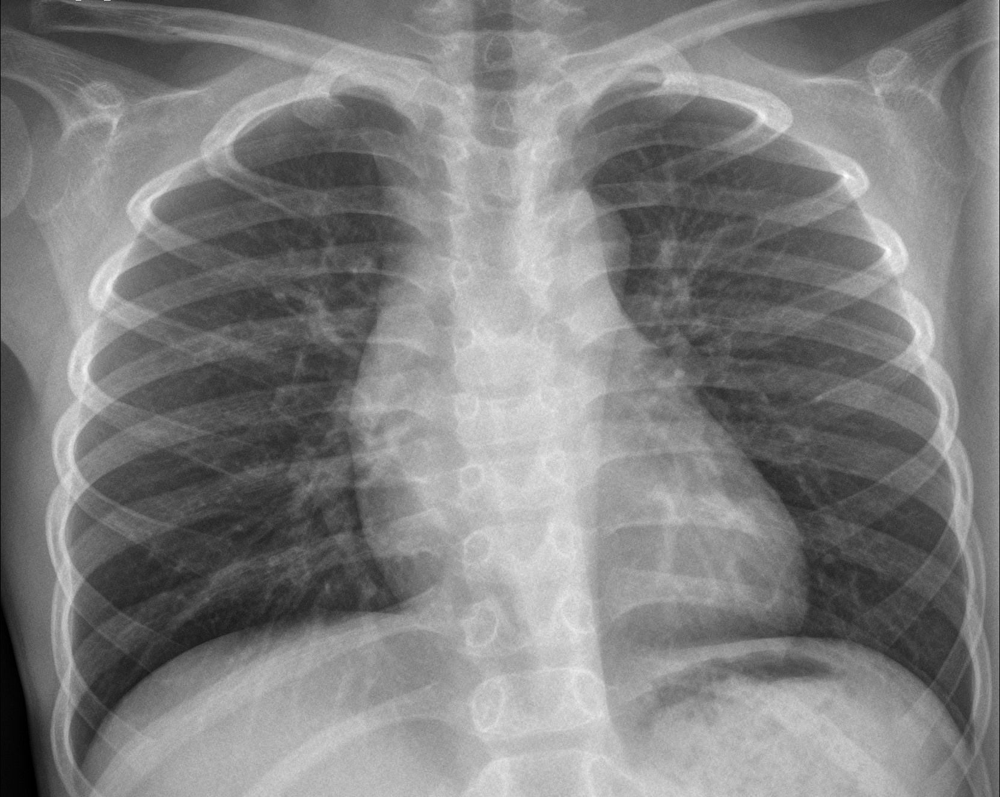
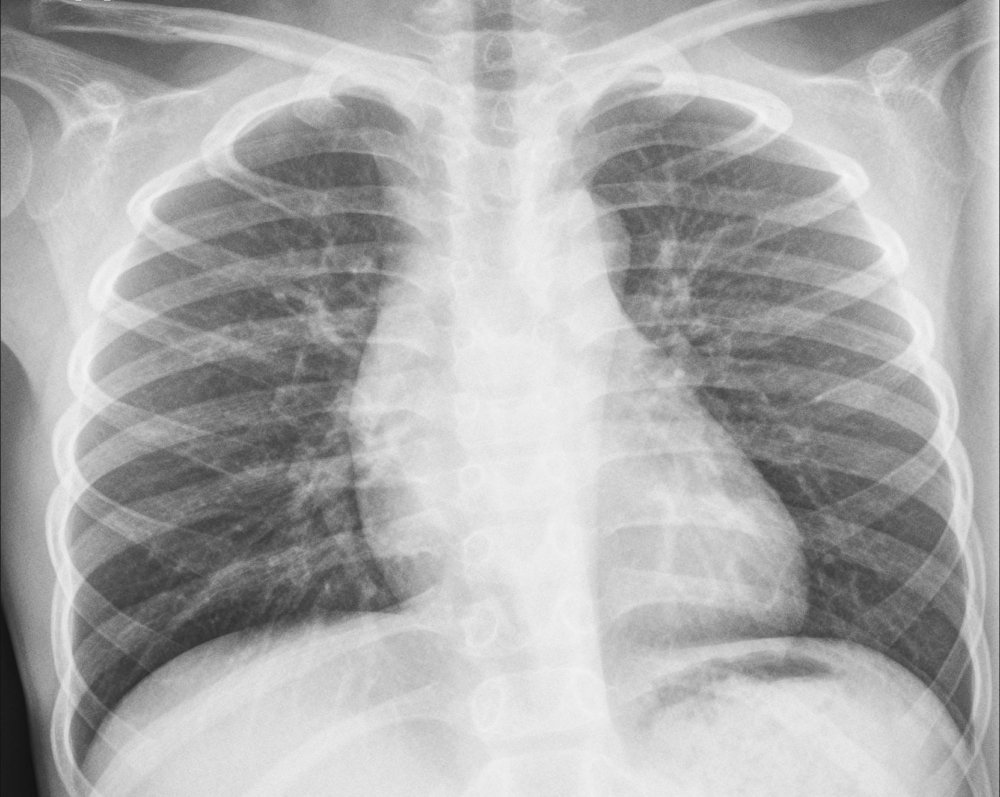
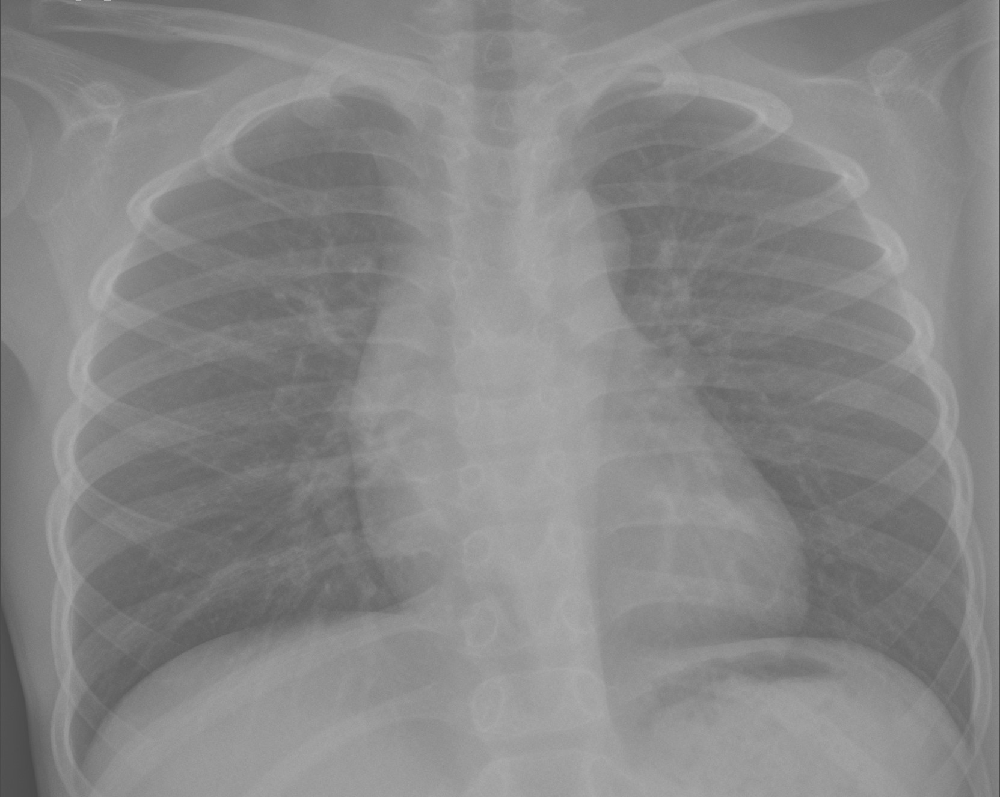


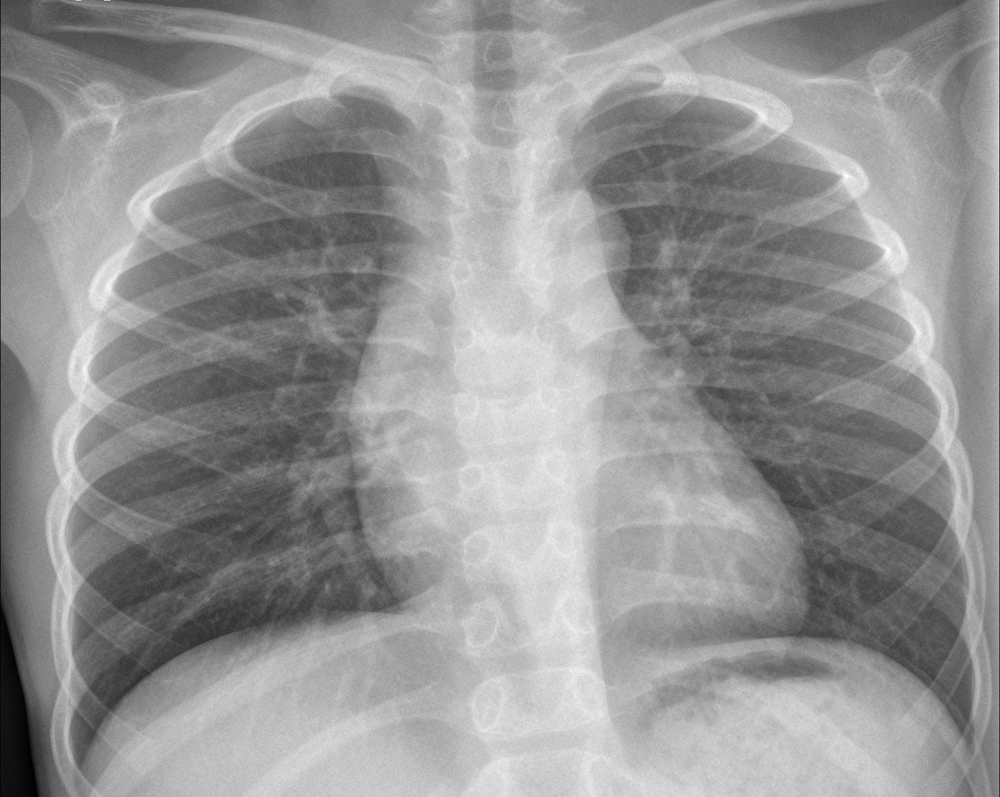
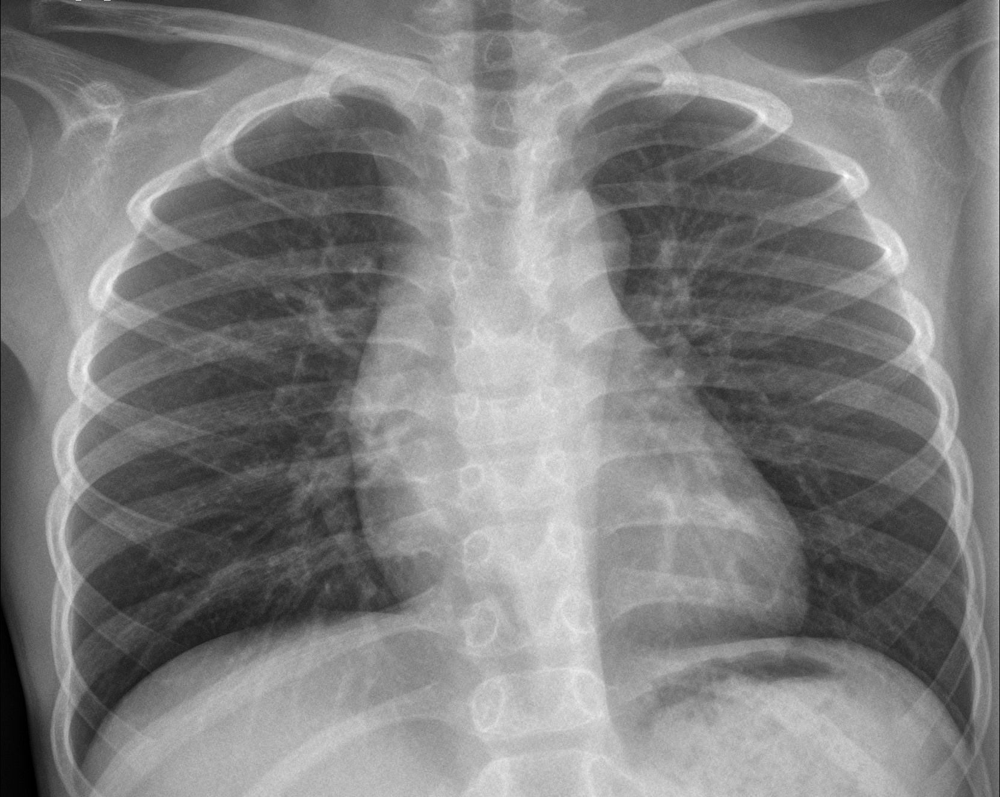
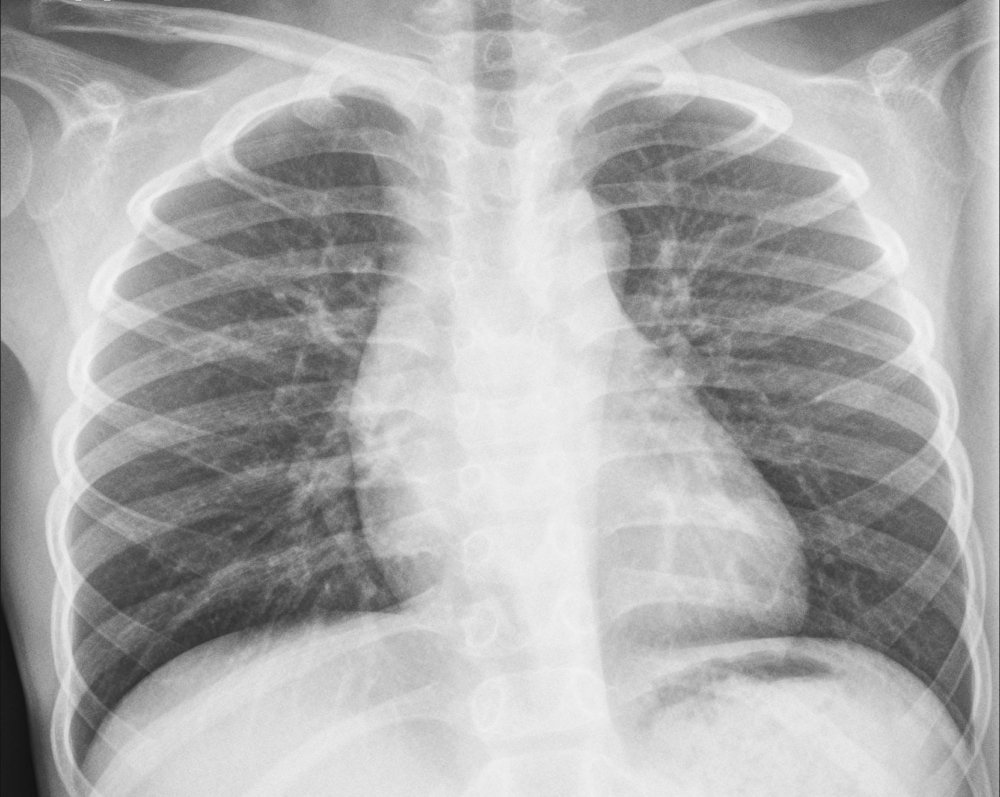
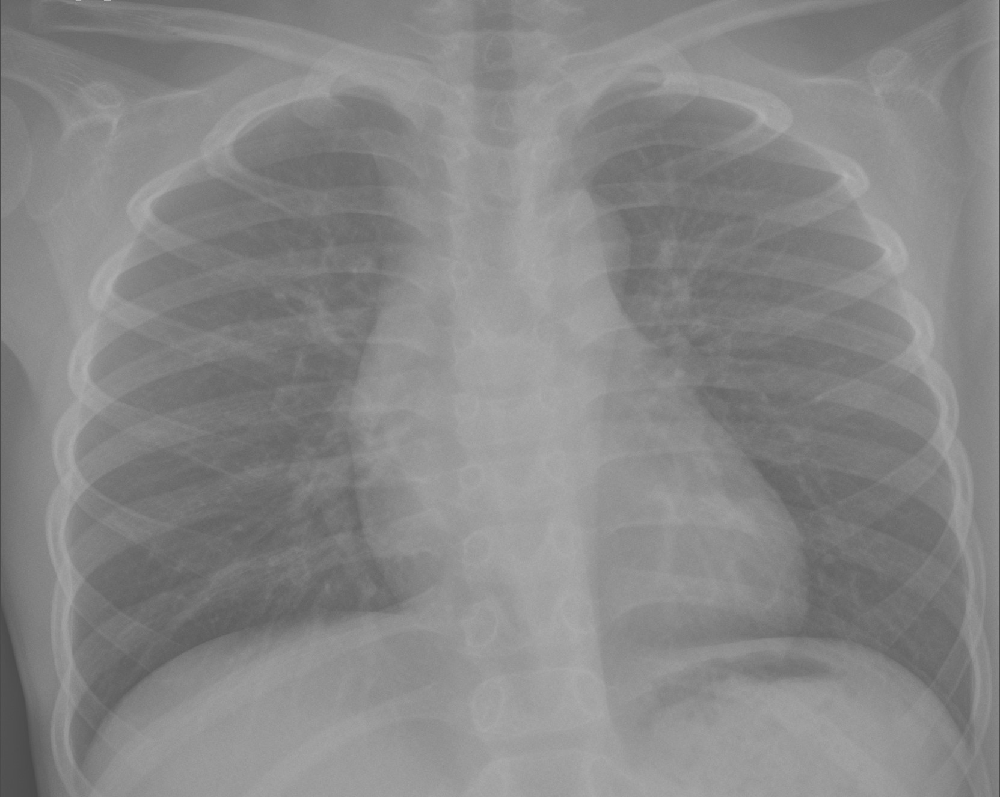

In [40]:
# Image Contrast
contrast=iaa.GammaContrast((0.5, 2.0))
contrast_sig = iaa.SigmoidContrast(gain=(5, 10), cutoff=(0.4, 0.6))
contrast_lin = iaa.LinearContrast((0.6, 0.4))
input_contrast = contrast.augment_image(input_img)
sigmoid_contrast = contrast_sig.augment_image(input_img)
linear_contrast = contrast_lin.augment_image(input_img)
images_list=[input_img, input_contrast,sigmoid_contrast,linear_contrast]
labels = ['Original', 'Gamma Contrast','SigmoidContrast','LinearContrast']
ipyplot.plot_images(images_list,labels=labels,img_width=180)

/usr/local/lib/python3.7/dist-packages/ipyplot/_utils.py:97: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return np.asarray(seq)



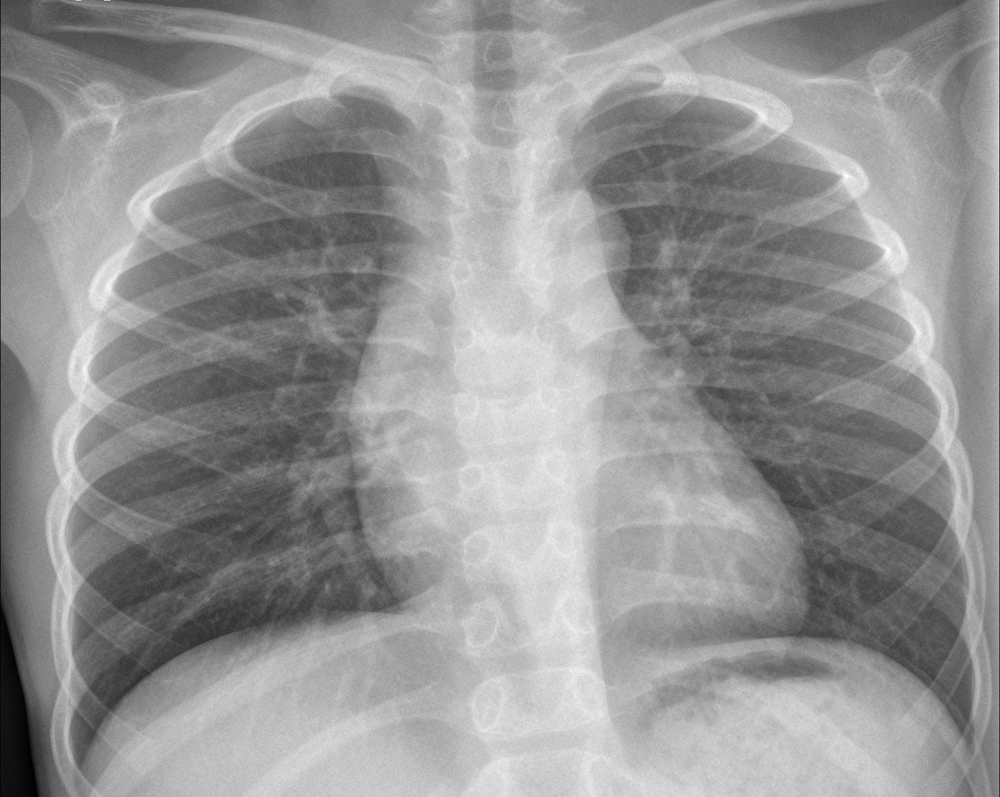
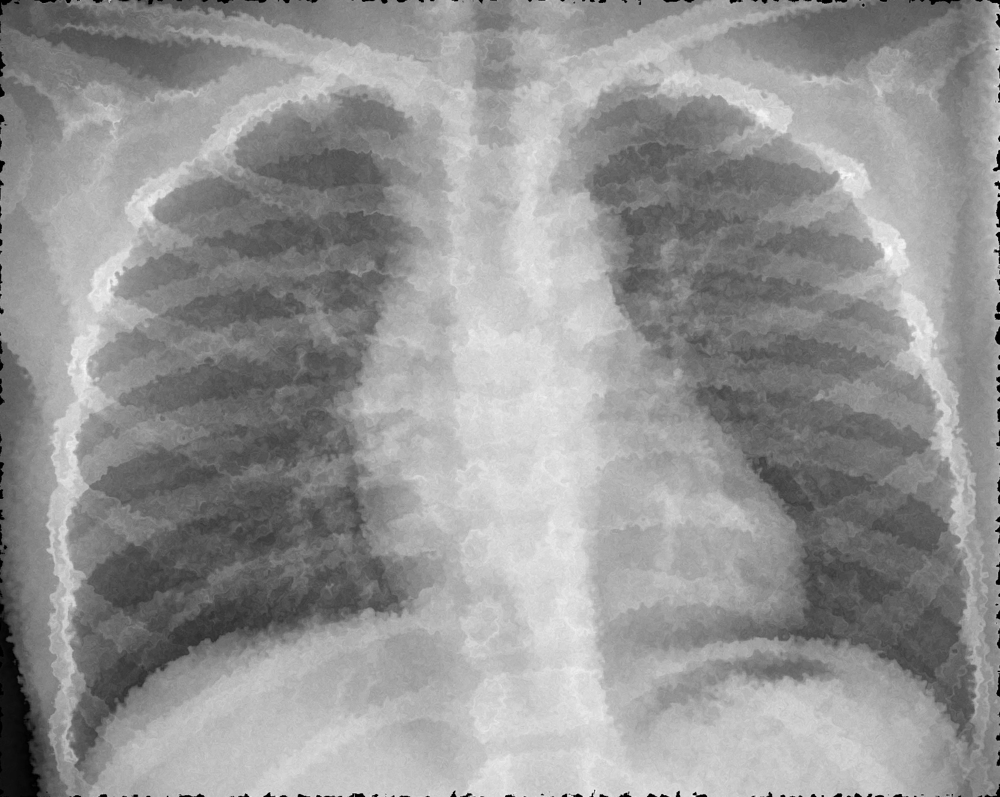
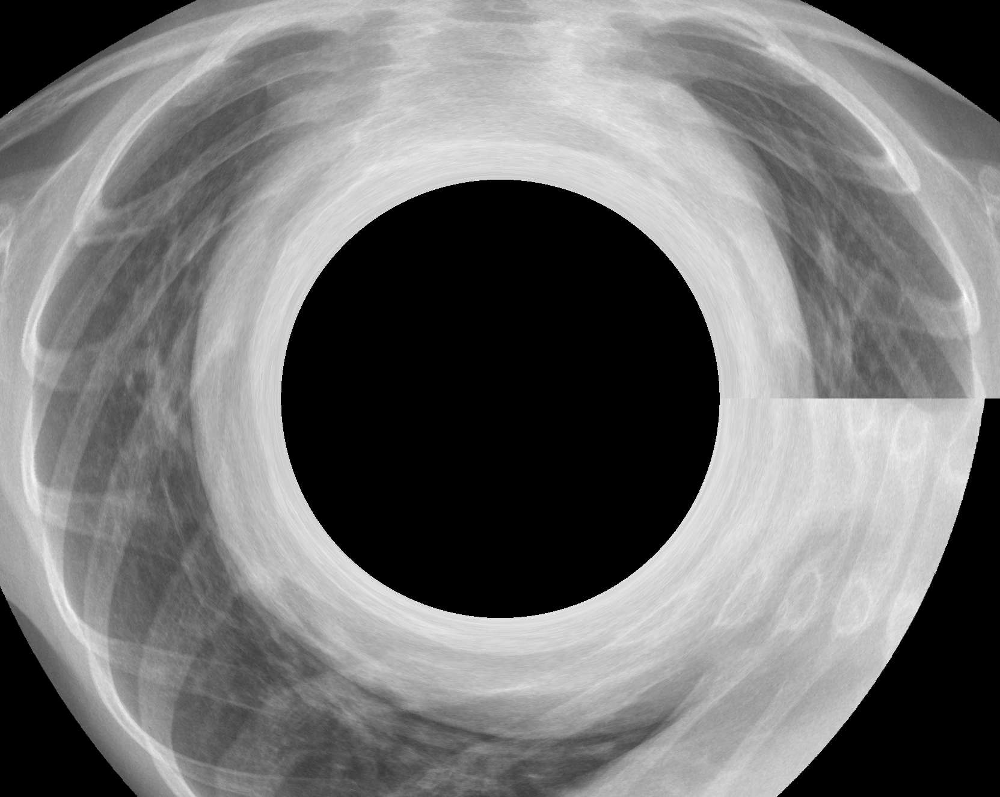
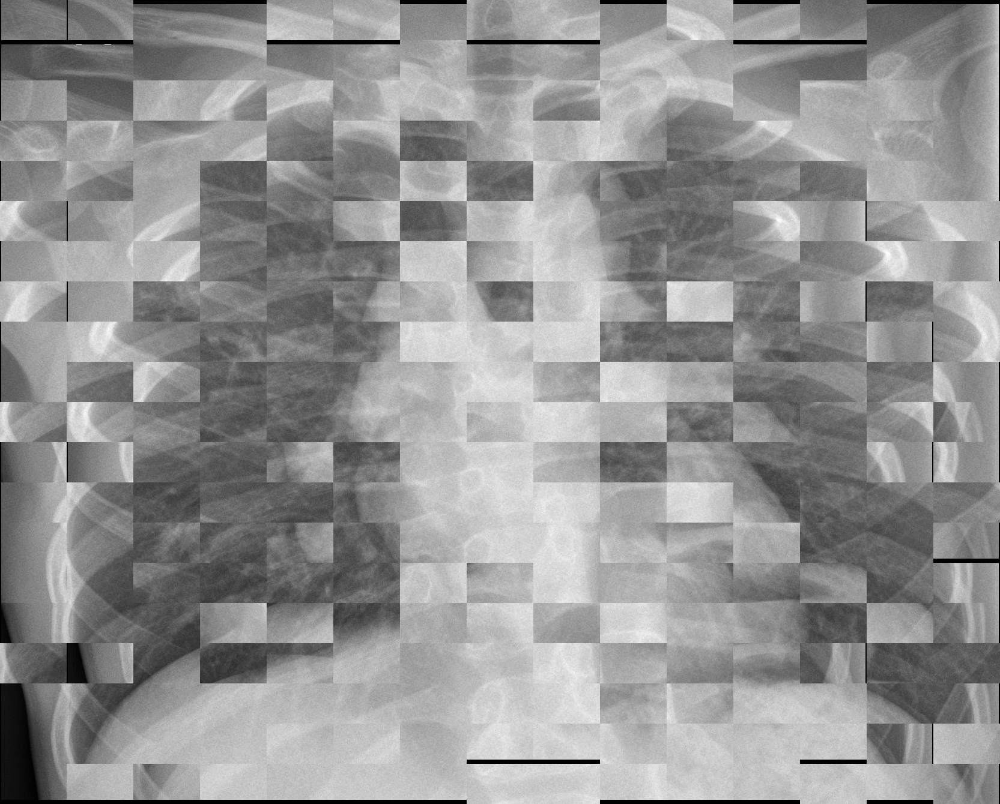


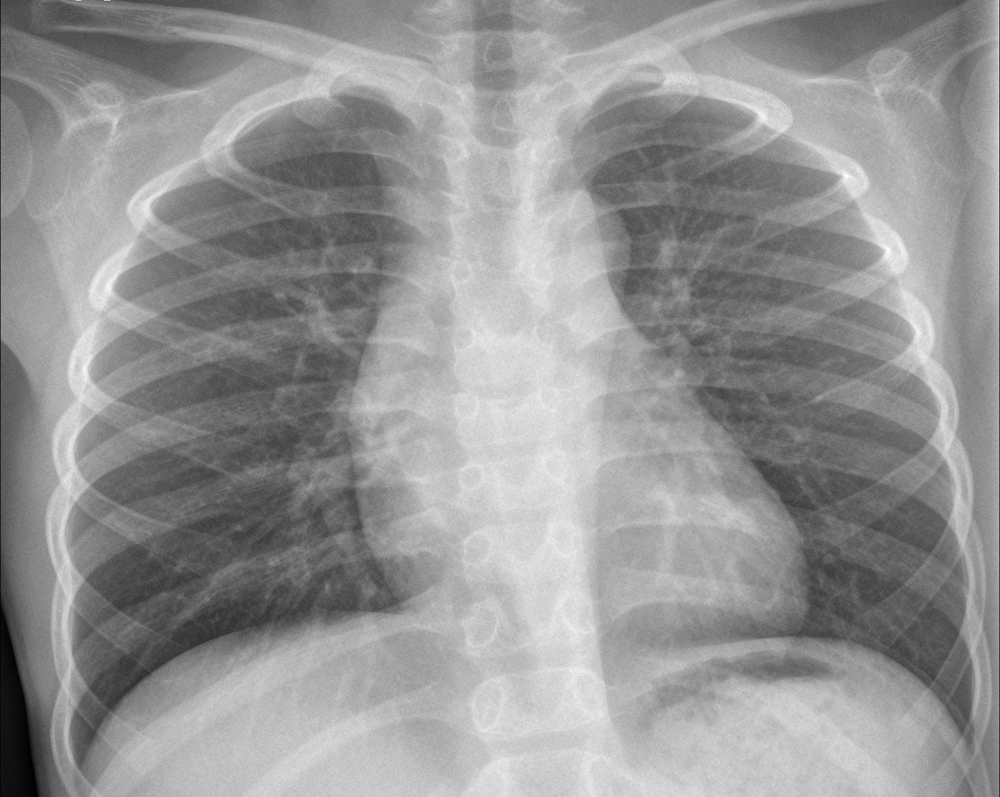
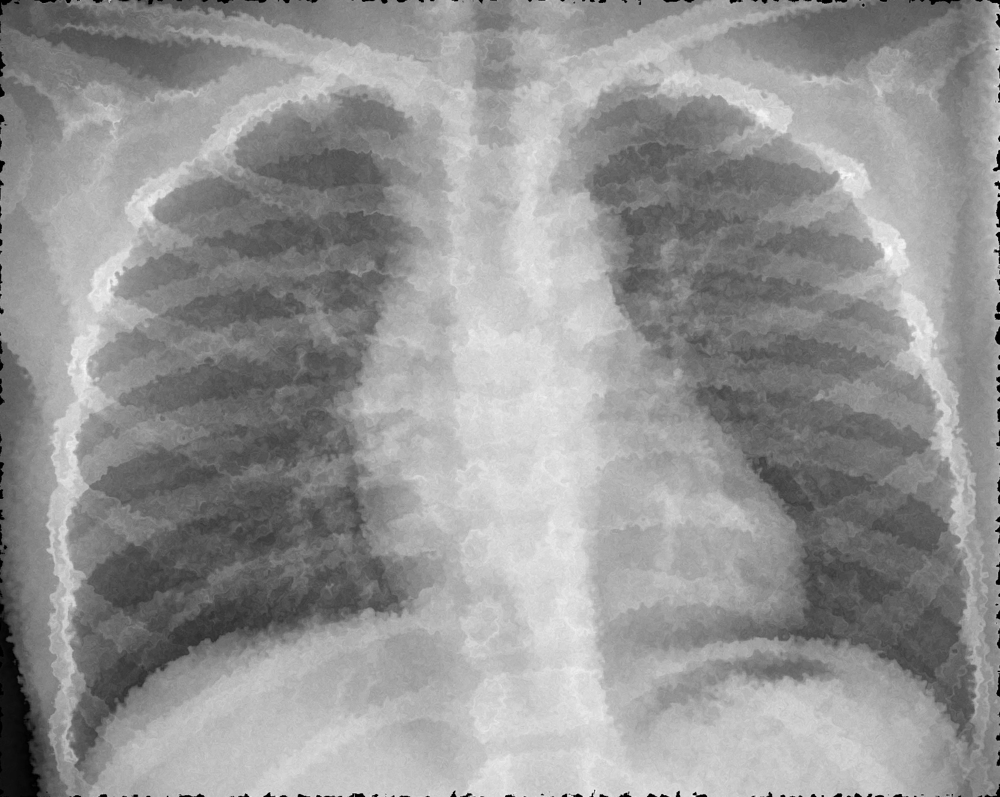
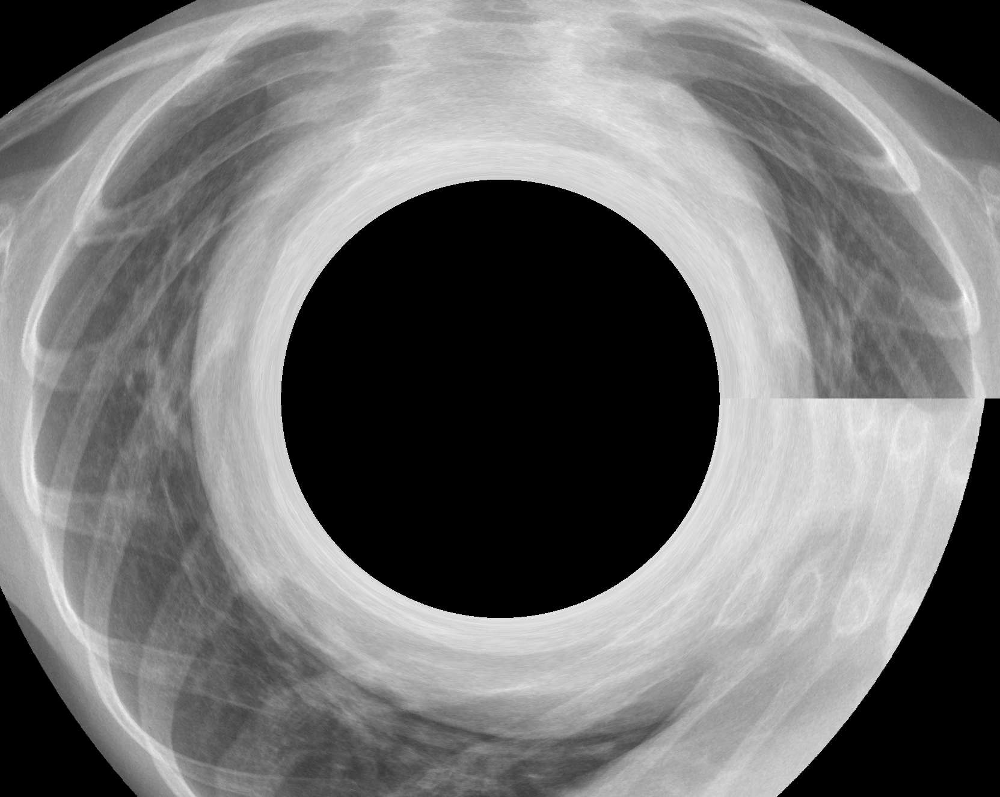
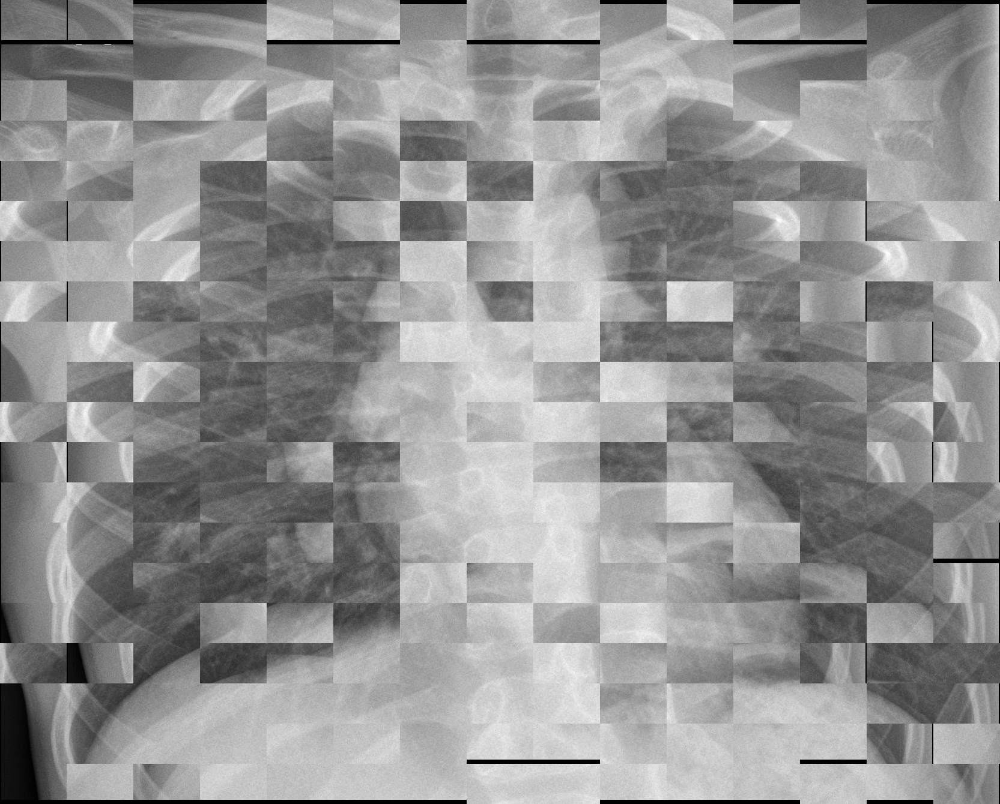

In [56]:
# Image Transformation
elastic = iaa.ElasticTransformation(alpha=60.0, sigma=4.0)
polar = iaa.WithPolarWarping(iaa.CropAndPad(percent=(-0.2, 0.7)))
jigsaw = iaa.Jigsaw(nb_rows=20, nb_cols=15, max_steps=(3, 7))
input_elastic = elastic.augment_image(input_img)
input_polar = polar.augment_image(input_img)
input_jigsaw = jigsaw.augment_image(input_img)
images_list=[input_img, input_elastic,input_polar,input_jigsaw]
labels = ['Original', 'elastic','polar','jigsaw']
ipyplot.plot_images(images_list,labels=labels,img_width=180)

In [43]:
def test_flip(img):
  #Horizontal Flip
  hflip = iaa.Fliplr(p=1.0)
  input_hf= hflip.augment_image(img)

  #Vertical Flip
  vflip= iaa.Flipud(p=1.0) 
  input_vf= vflip.augment_image(img)
  images_list=[img, input_hf, input_vf]
  labels = ['Original', 'Horizontally flipped', 'Vertically flipped']
  ipyplot.plot_images(images_list,labels=labels,img_width=180)



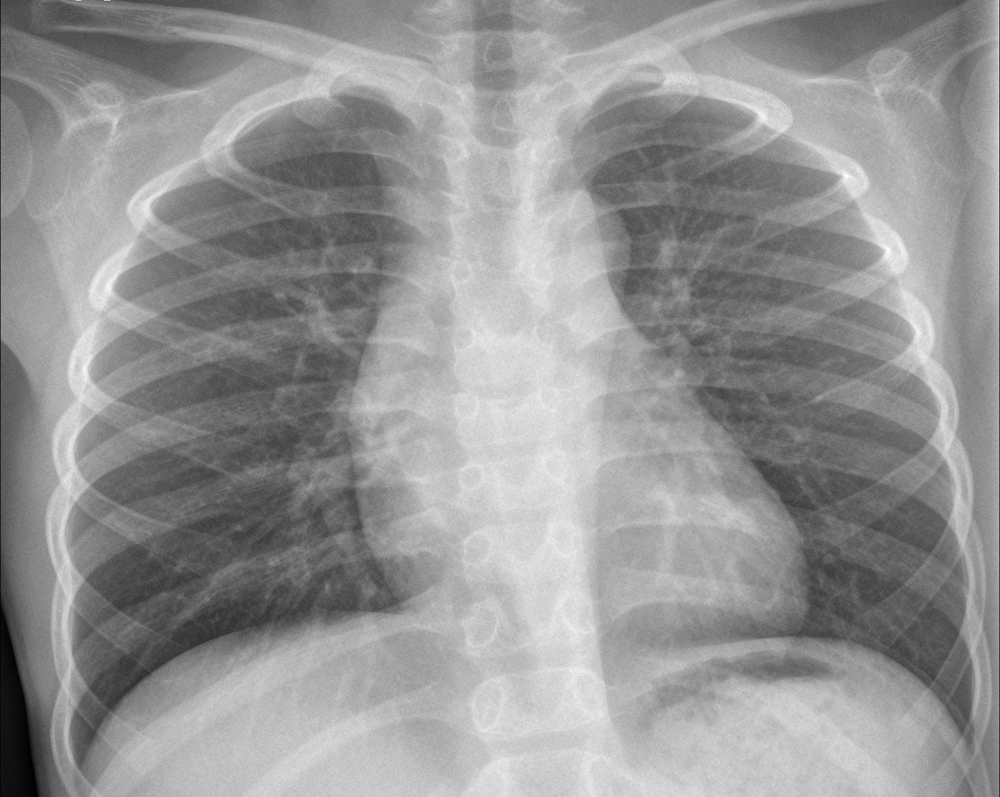
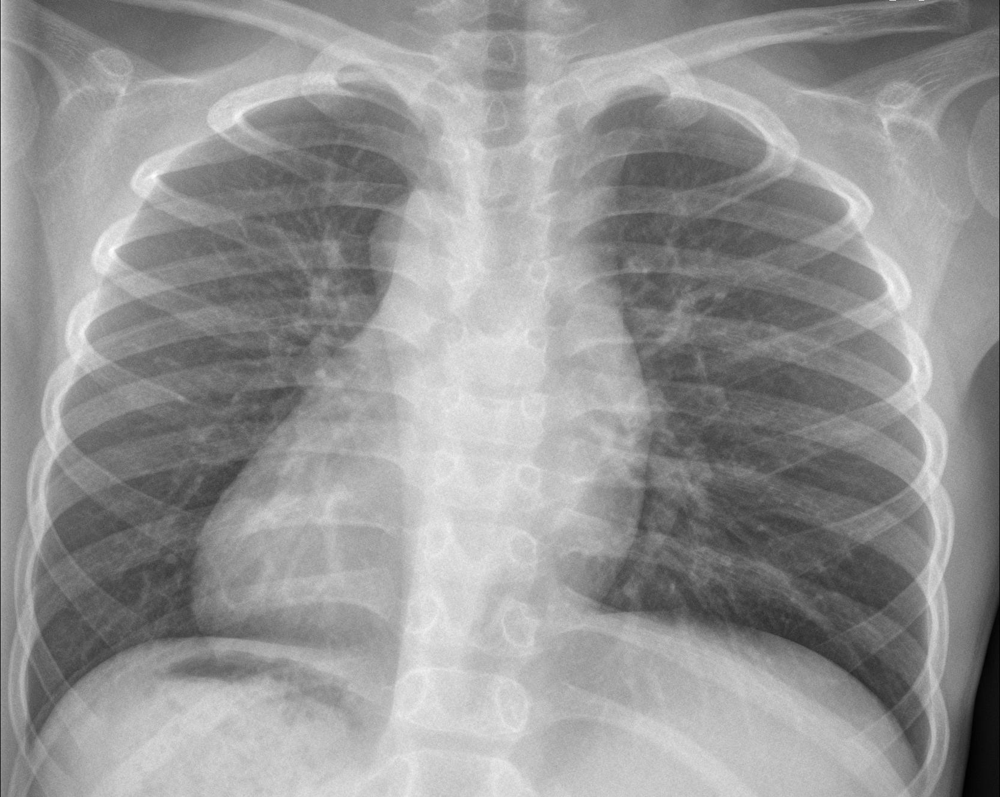
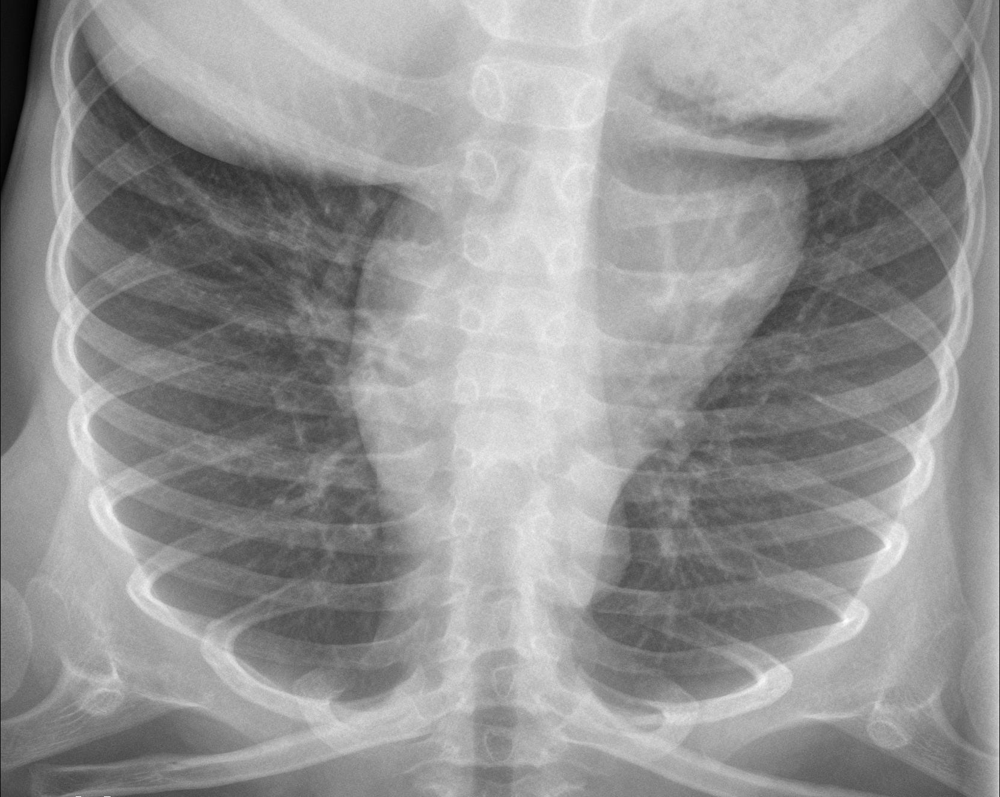


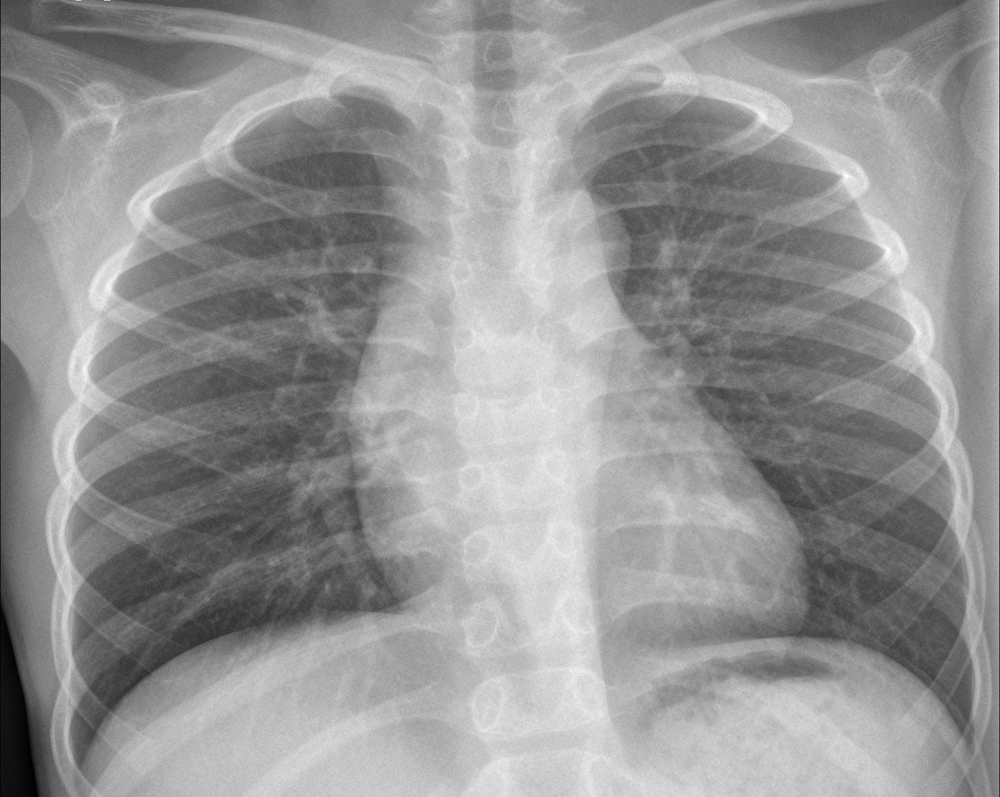
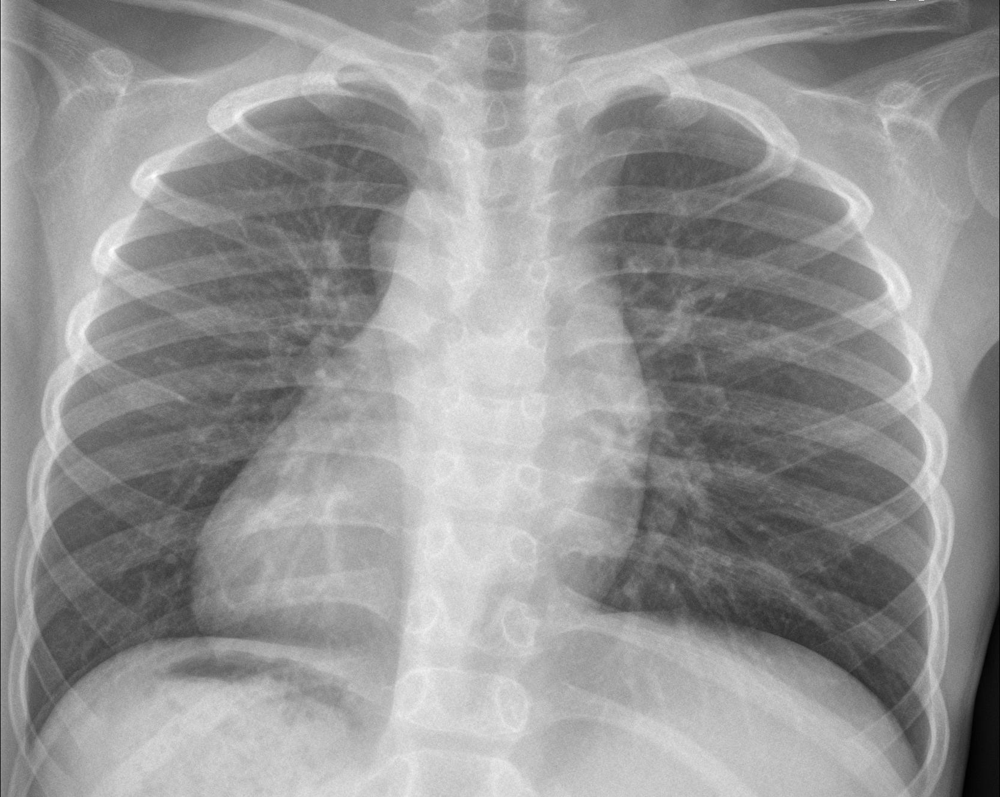
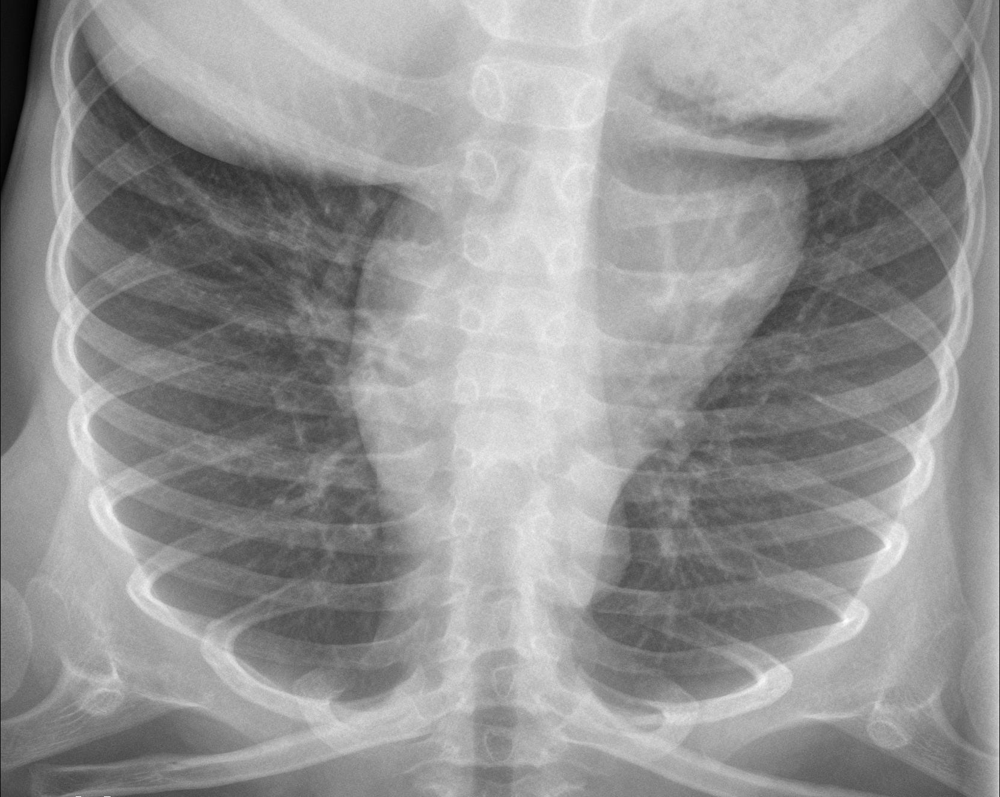

In [44]:
test_flip(input_img)

In [59]:
vflip= iaa.Flipud(p=1.0) 
input_vf= vflip.augment_image(input_img)

img_type = "jpeg"
url = "../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/augmented/"+"test_0."+ img_type
imageio.imwrite(url, input_vf, img_type, quality = 100)

We are done testing. We have reached our final step! Lets make functions for each of the features requested.
1. Flips
2. Rotation
3. Image Transformation
4. Image Contrast

In [62]:
test_img = imageio.imread('../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/IM-0006-0001.jpeg')
horizontal_flip(test_img,"000")

In [64]:
!ls ../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/ -alh

total 101M
drwx------ 3 root root  4.0K Nov  2 14:18 augmented
-rw------- 1 root root  247K Sep 28  2019 IM-0006-0001.jpeg
-rw------- 1 root root  399K Sep 28  2019 IM-0007-0001.jpeg
-rw------- 1 root root  390K Sep 28  2019 IM-0011-0001.jpeg
-rw------- 1 root root  300K Sep 28  2019 IM-0023-0001.jpeg
-rw------- 1 root root  444K Sep 28  2019 IM-0027-0001.jpeg
-rw------- 1 root root  332K Sep 28  2019 IM-0031-0001.jpeg
-rw------- 1 root root  407K Sep 28  2019 IM-0033-0001-0002.jpeg
-rw------- 1 root root  354K Sep 28  2019 IM-0036-0001.jpeg
-rw------- 1 root root  390K Sep 28  2019 IM-0039-0001.jpeg
-rw------- 1 root root  154K Sep 28  2019 IM-0109-0001.jpeg
-rw------- 1 root root  647K Sep 28  2019 IM-0141-0001.jpeg
-rw------- 1 root root  1.1M Sep 28  2019 IM-0147-0001.jpeg
-rw------- 1 root root  467K Sep 28  2019 IM-0178-0001.jpeg
-rw------- 1 root root  926K Sep 28  2019 IM-0191-0001.jpeg
-rw------- 1 root root  530K Sep 28  2019 IM-0215-0001.jpeg
-rw------- 1 root root  607K Sep

In [81]:
normal_img_list = [
"IM-0006-0001.jpeg",
"IM-0007-0001.jpeg",
"IM-0011-0001.jpeg",
"IM-0023-0001.jpeg",
"IM-0027-0001.jpeg",
"IM-0031-0001.jpeg",
"IM-0033-0001-0002.jpeg",
"IM-0036-0001.jpeg",
"IM-0039-0001.jpeg",
"IM-0109-0001.jpeg",
"IM-0141-0001.jpeg",
"IM-0147-0001.jpeg",
"IM-0178-0001.jpeg",
"IM-0191-0001.jpeg",
"IM-0215-0001.jpeg",
"IM-0216-0001.jpeg",
"IM-0223-0001.jpeg",
"IM-0225-0001.jpeg",
"IM-0239-0001.jpeg",
"IM-0243-0001.jpeg",
"IM-0285-0001.jpeg",
"IM-0291-0001.jpeg",
"IM-0294-0001.jpeg",
"IM-0302-0001.jpeg",
"IM-0305-0001.jpeg",
"IM-0314-0001.jpeg",
"IM-0317-0001.jpeg",
"IM-0332-0001.jpeg",
"IM-0333-0001.jpeg",
"IM-0349-0001.jpeg",
"IM-0351-0001.jpeg",
"IM-0353-0001.jpeg",
"IM-0355-0001.jpeg",
"IM-0362-0001.jpeg",
"IM-0368-0001.jpeg",
"IM-0370-0001.jpeg",
"IM-0377-0001.jpeg",
"IM-0384-0001.jpeg",
"IM-0385-0001.jpeg",
"IM-0403-0001.jpeg",
"IM-0408-0001.jpeg",
"IM-0424-0001.jpeg",
"IM-0438-0001.jpeg",
"IM-0442-0001.jpeg",
"IM-0444-0001.jpeg",
"IM-0448-0001.jpeg",
"IM-0449-0001.jpeg",
"IM-0458-0001.jpeg",
"IM-0460-0001.jpeg",
"IM-0463-0001.jpeg",
"IM-0473-0001.jpeg",
"IM-0476-0001.jpeg",
"IM-0478-0001.jpeg",
"IM-0482-0001.jpeg",
"IM-0486-0001.jpeg",
"IM-0499-0001-0001.jpeg",
"IM-0512-0001.jpeg",
"IM-0513-0001.jpeg",
"IM-0515-0001.jpeg",
"IM-0519-0001-0002.jpeg",
"IM-0525-0001.jpeg",
"IM-0545-0001-0001.jpeg",
"IM-0553-0001.jpeg",
"IM-0554-0001.jpeg",
"IM-0559-0001.jpeg",
"IM-0564-0001.jpeg",
"IM-0582-0001.jpeg",
"IM-0590-0001.jpeg",
"IM-0591-0001.jpeg",
"IM-0598-0001.jpeg",
"IM-0616-0001.jpeg",
"IM-0617-0001.jpeg",
"IM-0622-0001.jpeg",
"IM-0626-0001-0001.jpeg",
"IM-0626-0001-0002.jpeg",
"IM-0631-0001.jpeg",
"IM-0643-0001.jpeg",
"IM-0644-0001-0001.jpeg",
"IM-0652-0001-0002.jpeg",
"IM-0652-0001.jpeg",
"IM-0663-0001.jpeg",
"IM-0666-0001-0001.jpeg",
"IM-0677-0001.jpeg",
"IM-0700-0001.jpeg",
"IM-0732-0001.jpeg",
"IM-0739-0001.jpeg",
"IM-0755-0001.jpeg",
"IM-0757-0001.jpeg",
"NORMAL2-IM-0023-0001.jpeg",
"NORMAL2-IM-0041-0001.jpeg",
"NORMAL2-IM-0098-0001.jpeg",
"NORMAL2-IM-0105-0001.jpeg",
"NORMAL2-IM-0111-0001.jpeg",
"NORMAL2-IM-0117-0001.jpeg",
"NORMAL2-IM-0120-0001.jpeg",
"NORMAL2-IM-0146-0001.jpeg",
"NORMAL2-IM-0171-0001.jpeg",
"NORMAL2-IM-0246-0001.jpeg",
"NORMAL2-IM-0256-0001.jpeg",
"NORMAL2-IM-0304-0001.jpeg",
"NORMAL2-IM-0321-0001.jpeg",
"NORMAL2-IM-0327-0001.jpeg",
"NORMAL2-IM-0328-0001.jpeg",
"NORMAL2-IM-0336-0001.jpeg",
"NORMAL2-IM-0339-0001.jpeg",
"NORMAL2-IM-0346-0001.jpeg",
"NORMAL2-IM-0347-0001.jpeg",
"NORMAL2-IM-0349-0001.jpeg",
"NORMAL2-IM-0360-0001.jpeg",
"NORMAL2-IM-0395-0001-0002.jpeg",
"NORMAL2-IM-0406-0001.jpeg",
"NORMAL2-IM-0421-0001.jpeg",
"NORMAL2-IM-0455-0001.jpeg",
"NORMAL2-IM-0456-0001.jpeg",
"NORMAL2-IM-0464-0001.jpeg",
"NORMAL2-IM-0481-0001.jpeg",
"NORMAL2-IM-0482-0001.jpeg",
"NORMAL2-IM-0503-0001.jpeg",
"NORMAL2-IM-0517-0001.jpeg",
"NORMAL2-IM-0529-0001.jpeg",
"NORMAL2-IM-0563-0001.jpeg",
"NORMAL2-IM-0566-0001.jpeg",
"NORMAL2-IM-0569-0001.jpeg",
"NORMAL2-IM-0585-0001.jpeg",
"NORMAL2-IM-0589-0001.jpeg",
"NORMAL2-IM-0601-0001.jpeg",
"NORMAL2-IM-0603-0001.jpeg",
"NORMAL2-IM-0637-0001.jpeg",
"NORMAL2-IM-0649-0001.jpeg",
"NORMAL2-IM-0653-0001.jpeg",
"NORMAL2-IM-0659-0001.jpeg",
"NORMAL2-IM-0682-0001.jpeg",
"NORMAL2-IM-0693-0001.jpeg",
"NORMAL2-IM-0705-0001.jpeg",
"NORMAL2-IM-0736-0001.jpeg",
"NORMAL2-IM-0771-0001.jpeg",
"NORMAL2-IM-0772-0001.jpeg",
"NORMAL2-IM-0809-0001.jpeg",
"NORMAL2-IM-0812-0001.jpeg",
"NORMAL2-IM-0824-0001.jpeg",
"NORMAL2-IM-0826-0001.jpeg",
"NORMAL2-IM-0828-0001.jpeg",
"NORMAL2-IM-0837-0001.jpeg",
"NORMAL2-IM-0840-0001.jpeg",
"NORMAL2-IM-0853-0001.jpeg",
"NORMAL2-IM-0869-0001.jpeg",
"NORMAL2-IM-0871-0001.jpeg",
"NORMAL2-IM-0872-0001.jpeg",
"NORMAL2-IM-0877-0001.jpeg",
"NORMAL2-IM-0893-0001.jpeg",
"NORMAL2-IM-0904-0001.jpeg",
"NORMAL2-IM-0905-0001.jpeg",
"NORMAL2-IM-0907-0001.jpeg",
"NORMAL2-IM-0925-0001.jpeg",
"NORMAL2-IM-0967-0001.jpeg",
"NORMAL2-IM-0975-0001.jpeg",
"NORMAL2-IM-0994-0001.jpeg",
"NORMAL2-IM-0997-0001.jpeg",
"NORMAL2-IM-0998-0001.jpeg",
"NORMAL2-IM-1024-0001.jpeg",
"NORMAL2-IM-1038-0001.jpeg",
"NORMAL2-IM-1040-0001.jpeg",
"NORMAL2-IM-1053-0001.jpeg",
"NORMAL2-IM-1054-0001.jpeg",
"NORMAL2-IM-1056-0001.jpeg",
"NORMAL2-IM-1060-0001.jpeg",
"NORMAL2-IM-1090-0001.jpeg",
"NORMAL2-IM-1093-0001.jpeg",
"NORMAL2-IM-1094-0001.jpeg",
"NORMAL2-IM-1109-0001.jpeg",
"NORMAL2-IM-1116-0001-0001.jpeg",
"NORMAL2-IM-1123-0001.jpeg",
"NORMAL2-IM-1141-0001.jpeg",
"NORMAL2-IM-1148-0001.jpeg",
"NORMAL2-IM-1152-0001-0001.jpeg",
"NORMAL2-IM-1152-0001-0002.jpeg",
"NORMAL2-IM-1152-0001.jpeg",
"NORMAL2-IM-1163-0001.jpeg",
"NORMAL2-IM-1170-0001.jpeg",
"NORMAL2-IM-1177-0001.jpeg",
"NORMAL2-IM-1183-0001.jpeg",
"NORMAL2-IM-1194-0001.jpeg",
"NORMAL2-IM-1218-0001.jpeg",
"NORMAL2-IM-1225-0001.jpeg",
"NORMAL2-IM-1231-0001.jpeg",
"NORMAL2-IM-1252-0001.jpeg",
"NORMAL2-IM-1276-0001.jpeg",
"NORMAL2-IM-1282-0001.jpeg",
"NORMAL2-IM-1294-0001-0002.jpeg",
"NORMAL2-IM-1301-0001.jpeg",
"NORMAL2-IM-1332-0001.jpeg",
"NORMAL2-IM-1334-0001.jpeg",
"NORMAL2-IM-1335-0001.jpeg",
"NORMAL2-IM-1337-0001.jpeg",
"NORMAL2-IM-1345-0001-0002.jpeg",
"NORMAL2-IM-1371-0001.jpeg",
"NORMAL2-IM-1379-0001.jpeg",
"NORMAL2-IM-1385-0001.jpeg",
"NORMAL2-IM-1401-0001.jpeg",
"NORMAL2-IM-1436-0001.jpeg"

]

In [94]:
def vertical_flip(img_obj, index):
  vflip= iaa.Flipud(p=1.0) 
  changed_img= vflip.augment_image(img_obj)
  
  img_type = "jpeg"
  url = "../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/augmented/vertical_flip/"+"vflip_"+index+"."+ img_type
  imageio.imwrite(url, changed_img, img_type, quality = 100)

In [93]:
def horizontal_flip(img_obj, index):
  hflip = iaa.Fliplr(p=1.0)
  changed_img = hflip.augment_image(img_obj)

  img_type = "jpeg"
  url = "../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/augmented/horizontal_flip/"+"hflip_"+index+"."+ img_type
  imageio.imwrite(url, changed_img, img_type, quality = 100)

In [92]:
def image_contrast(img_obj, index):
  contrast=iaa.GammaContrast((0.5, 2.0))
  contrast_sig = iaa.SigmoidContrast(gain=(5, 10), cutoff=(0.4, 0.6))
  contrast_lin = iaa.LinearContrast((0.6, 0.4))

  input_contrast = contrast.augment_image(img_obj)
  sigmoid_contrast = contrast_sig.augment_image(img_obj)
  linear_contrast = contrast_lin.augment_image(img_obj)

  img_type = "jpeg"
  path = "../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/augmented/image_contrast/"

  prefix = "ic_" # ic = input contrast
  url = path+prefix+index+"."+ img_type
  imageio.imwrite(url, input_contrast, img_type, quality = 100)

  prefix = "sigmoid_contrast_" 
  url = path+prefix+index+"."+ img_type
  imageio.imwrite(url, sigmoid_contrast, img_type, quality = 100)

  prefix = "linear_contrast_" 
  url = path+prefix+index+"."+ img_type
  imageio.imwrite(url, linear_contrast, img_type, quality = 100)

In [91]:
def image_transformation(img_obj, index):
  elastic = iaa.ElasticTransformation(alpha=60.0, sigma=4.0)
  polar = iaa.WithPolarWarping(iaa.CropAndPad(percent=(-0.2, 0.7)))
  jigsaw = iaa.Jigsaw(nb_rows=20, nb_cols=15, max_steps=(3, 7))

  input_elastic = elastic.augment_image(img_obj)
  input_polar = polar.augment_image(img_obj)
  input_jigsaw = jigsaw.augment_image(img_obj)
  img_type = "jpeg"

  path = "../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/augmented/image_transformation/"

  prefix = "elastic_transform_" # ic = input contrast
  url = path+prefix+index+"."+ img_type
  imageio.imwrite(url, input_elastic, img_type, quality = 100)

  prefix = "polar_transform_" # ic = input contrast
  url = path+prefix+index+"."+ img_type
  imageio.imwrite(url, input_polar, img_type, quality = 100)

  prefix = "jigsaw_transform_" # ic = input contrast
  url = path+prefix+index+"."+ img_type
  imageio.imwrite(url, input_jigsaw, img_type, quality = 100)

In [90]:
index = 0
img_type = "jpeg"

for img_name in normal_img_list:
  img_object = imageio.imread('../content/drive/MyDrive/temp/Dataset/chest_xray/NORMAL/'+img_name)
  horizontal_flip(img_object, str(index))
  vertical_flip(img_object, str(index))
  image_contrast(img_object, str(index))
  image_transformation(img_object, str(index))
  index = index + 1

Done!

<h1>Pneumonia</h1>